In [ ]:
#To parse the band data and spin data from .dat dat.1 dat.2 dat.3 file 
# Define the file path
file_path = 'cu_0.075_900_band.dat.3'

# Initialize a list to hold the data
kx_ky_kz_nbnd_data = []

# Open and read the contents of the file
with open(file_path, 'r') as file:
    file_contents = file.readlines()

# Extract nbnd and nks values from the header (first line)
header_line = file_contents[0]
nbnd = int(header_line.split('nbnd=')[1].split(',')[0].strip())  # Number of nbnd values
nks = int(header_line.split('nks=')[1].split('/')[0].strip())    # Number of k-points

# Initialize an index to iterate through the file contents
i = 1  # Skip the first line (header)

# Iterate through the file, handling both coordinates and nbnd values
while i < len(file_contents):
    # Extract the kx, ky, kz coordinates (first 3 values on the current line)
    current_line = list(map(float, file_contents[i].strip().split()))
    
    # Extract the kx, ky, kz
    kx_ky_kz = current_line[:3]
    
    # Initialize an empty list to store the nbnd values
    nbnd_values = current_line[3:]
    
    # If the current line has additional nbnd values spanning multiple lines
    while len(nbnd_values) < nbnd:
        i += 1
        nbnd_values.extend(list(map(float, file_contents[i].strip().split())))
    
    # Append the kx, ky, kz coordinates followed by nbnd values to the final data list
    kx_ky_kz_nbnd_data.append(kx_ky_kz + nbnd_values)
    
    # Move to the next line that starts a new kx, ky, kz coordinate set
    i += 1

# Print the reformatted data to verify
#for row in kx_ky_kz_nbnd_data:
#    print(row)

# Optionally, save the data to a CSV file
import csv
output_csv = 'cu_0.075_sz_parse.csv'
with open(output_csv, 'w', newline='') as csvfile:
    # Create a dynamic header based on the number of nbnd values
    header = ['kx', 'ky', 'kz'] + [f'nbnd_{i+1}' for i in range(nbnd)]
    writer = csv.writer(csvfile)
    writer.writerow(header)  # Write header
    writer.writerows(kx_ky_kz_nbnd_data)  # Write data rows

print(f"Data saved to {output_csv}")

Bands crossing the target energy (10.1884): ['nbnd_439', 'nbnd_440', 'nbnd_441', 'nbnd_442']


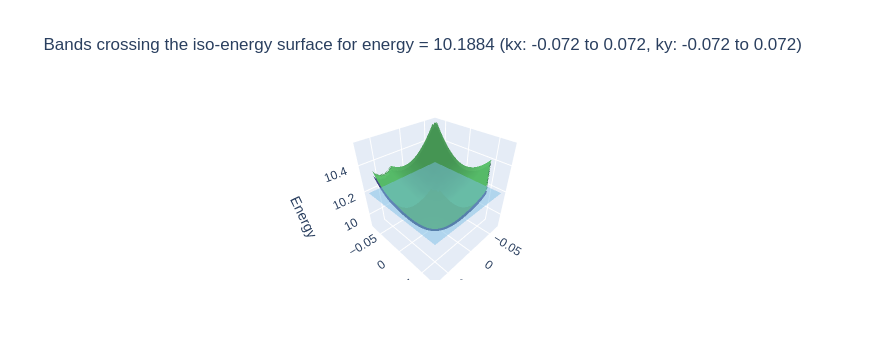

Intersection data saved to 'intersection_kx_ky.csv'.


In [29]:
#To plot the iso surface and the band for a range of kx and ky and save the intersection coordinates(kx,ky) 
#with band index
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from scipy.interpolate import griddata

# Load the dataset
file_path = 'cu_0.075_bands_parse.csv'
df = pd.read_csv(file_path)

# Define the range for kx and ky
kx_min = -0.072  # Set your desired min value for kx
kx_max = 0.072   # Set your desired max value for kx
ky_min = -0.072  # Set your desired min value for ky
ky_max = 0.072   # Set your desired max value for ky

# Filter the data based on the kx and ky range
df_filtered = df[(df['kx'] >= kx_min) & (df['kx'] <= kx_max) &
                 (df['ky'] >= ky_min) & (df['ky'] <= ky_max)]

# Extract the filtered kx and ky
kx = df_filtered['kx']
ky = df_filtered['ky']

# Define the target iso-energy level
target_energy = 10.1884  # Set this to the energy level you're interested in

# List to store bands that cross the target energy and the intersection coordinates
crossing_bands = []
intersection_data = []

# Tolerance for intersection
tolerance = 1e-2

# Loop through all the columns for the bands (assuming band columns start from 'nbnd_')
for col in df_filtered.columns:
    if col.startswith('nbnd_'):
        energy = df_filtered[col]
        # Check if the band crosses the target energy within tolerance
        if energy.min() <= target_energy <= energy.max():
            crossing_bands.append(col)
            
            # Find the kx, ky values where the band intersects the iso-energy plane
            intersection_points = df_filtered[np.abs(energy - target_energy) <= tolerance]
            if not intersection_points.empty:
                for _, row in intersection_points.iterrows():
                    kx_intersect = row['kx']
                    ky_intersect = row['ky']
                    intersection_data.append({
                        'band': col,
                        'kx': kx_intersect,
                        'ky': ky_intersect
                    })

# If no band crosses the target energy, print a message and stop
if not crossing_bands:
    print(f"No bands cross the target energy of {target_energy}.")
else:
    print(f"Bands crossing the target energy ({target_energy}): {crossing_bands}")

    # Create a 3D plot for the bands and the iso-energy surface
    fig = go.Figure()

    # Create a grid for kx and ky within the filtered range
    kx_range = np.linspace(kx.min(), kx.max(), 100)
    ky_range = np.linspace(ky.min(), ky.max(), 100)
    kx_grid, ky_grid = np.meshgrid(kx_range, ky_range)

    # Plot each band as a surface
    for i, band in enumerate(crossing_bands):
        energy = df_filtered[band]

        # Interpolate the energy values on a grid for continuous surface plotting
        energy_grid = griddata((kx, ky), energy, (kx_grid, ky_grid), method='cubic')
        
        # Plot the band as a surface
        fig.add_trace(go.Surface(
            x=kx_grid,
            y=ky_grid,
            z=energy_grid,
            colorscale='Viridis',
            opacity=0.8,
            name=f'Band {band}',
            showscale=False,
            surfacecolor=np.full_like(energy_grid, i),  # Use the band index for color differentiation
            cmin=0,
            cmax=len(crossing_bands)
        ))

    # Plot the iso-energy surface as a plane
    iso_energy_surface = np.full_like(kx_grid, target_energy)

    fig.add_trace(go.Surface(
        x=kx_grid,
        y=ky_grid,
        z=iso_energy_surface,
        colorscale='Blues',
        opacity=0.5,
        showscale=False,
        name='Iso-energy surface'
    ))

    # Add labels and title
    fig.update_layout(scene=dict(
                        xaxis_title='kx',
                        yaxis_title='ky',
                        zaxis_title='Energy'),
                      title=f"Bands crossing the iso-energy surface for energy = {target_energy} (kx: {kx_min} to {kx_max}, ky: {ky_min} to {ky_max})")

    # Show the plot
    fig.show()

    # Save the intersection data to a CSV file
    intersection_df = pd.DataFrame(intersection_data)
    intersection_df.to_csv('intersection_kx_ky.csv', index=False)
    print("Intersection data saved to 'intersection_kx_ky.csv'.")


Bands crossing the target energy (10.1884): ['nbnd_435', 'nbnd_436', 'nbnd_437', 'nbnd_438', 'nbnd_439', 'nbnd_440', 'nbnd_441', 'nbnd_442']


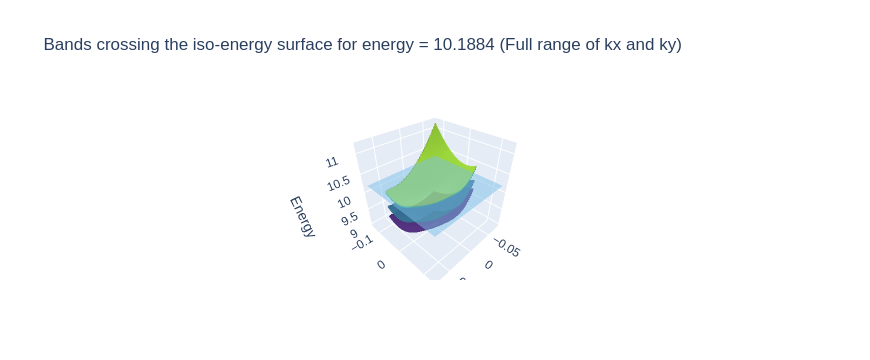

Intersection data saved to 'intersection_kx_ky_whole.csv'.


In [30]:
#To plot the iso surface and the band for the whole kx,ky range and save the intersection coordinates(kx,ky) 
#with band index
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from scipy.interpolate import griddata

# Load the dataset
file_path = 'cu_0.075_bands_parse.csv'
df = pd.read_csv(file_path)

# Extract the full kx and ky values from the dataset
kx = df['kx']
ky = df['ky']

# Define the target iso-energy level
target_energy = 10.1884  # Set this to the energy level you're interested in

# List to store bands that cross the target energy and the intersection coordinates
crossing_bands = []
intersection_data = []

# Tolerance for intersection
tolerance = 1e-2

# Loop through all the columns for the bands (assuming band columns start from 'nbnd_')
for col in df.columns:
    if col.startswith('nbnd_'):
        energy = df[col]
        # Check if the band crosses the target energy within tolerance
        if energy.min() <= target_energy <= energy.max():
            crossing_bands.append(col)
            
            # Find the kx, ky values where the band intersects the iso-energy plane
            intersection_points = df[np.abs(energy - target_energy) <= tolerance]
            if not intersection_points.empty:
                for _, row in intersection_points.iterrows():
                    kx_intersect = row['kx']
                    ky_intersect = row['ky']
                    intersection_data.append({
                        'band': col,
                        'kx': kx_intersect,
                        'ky': ky_intersect
                    })

# If no band crosses the target energy, print a message and stop
if not crossing_bands:
    print(f"No bands cross the target energy of {target_energy}.")
else:
    print(f"Bands crossing the target energy ({target_energy}): {crossing_bands}")

    # Create a 3D plot for the bands and the iso-energy surface
    fig = go.Figure()

    # Create a grid for kx and ky using the entire range
    kx_range = np.linspace(kx.min(), kx.max(), 100)
    ky_range = np.linspace(ky.min(), ky.max(), 100)
    kx_grid, ky_grid = np.meshgrid(kx_range, ky_range)

    # Plot each band as a surface
    for i, band in enumerate(crossing_bands):
        energy = df[band]

        # Interpolate the energy values on a grid for continuous surface plotting
        energy_grid = griddata((kx, ky), energy, (kx_grid, ky_grid), method='cubic')
        
        # Plot the band as a surface
        fig.add_trace(go.Surface(
            x=kx_grid,
            y=ky_grid,
            z=energy_grid,
            colorscale='Viridis',
            opacity=0.8,
            name=f'Band {band}',
            showscale=False,
            surfacecolor=np.full_like(energy_grid, i),  # Use the band index for color differentiation
            cmin=0,
            cmax=len(crossing_bands)
        ))

    # Plot the iso-energy surface as a plane
    iso_energy_surface = np.full_like(kx_grid, target_energy)

    fig.add_trace(go.Surface(
        x=kx_grid,
        y=ky_grid,
        z=iso_energy_surface,
        colorscale='Blues',
        opacity=0.5,
        showscale=False,
        name='Iso-energy surface'
    ))

    # Add labels and title
    fig.update_layout(scene=dict(
                        xaxis_title='kx',
                        yaxis_title='ky',
                        zaxis_title='Energy'),
                      title=f"Bands crossing the iso-energy surface for energy = {target_energy} (Full range of kx and ky)")

    # Show the plot
    fig.show()

    # Save the intersection data to a CSV file
    intersection_df = pd.DataFrame(intersection_data)
    intersection_df.to_csv('intersection_kx_ky_whole.csv', index=False)
    print("Intersection data saved to 'intersection_kx_ky_whole.csv'.")


In [34]:
#To get the spin expectation at those intersecting (kx,ky) coordinates of the corresponding band

import pandas as pd

# Load the intersection data
intersection_file = 'intersection_kx_ky.csv'  # The file where the kx, ky, and band names are saved
intersection_df = pd.read_csv(intersection_file)

# Load the CSV files with spin data (sx, sy, sz)
sx_file = 'cu_0.075_sx_parse.csv'  # File containing sx values
sy_file = 'cu_0.075_sy_parse.csv'  # File containing sy values
sz_file = 'cu_0.075_sz_parse.csv'  # File containing sz values

sx_df = pd.read_csv(sx_file)
sy_df = pd.read_csv(sy_file)
sz_df = pd.read_csv(sz_file)

# List to store the spin expectation values at the intersection points
spin_expectations_at_intersections = []

# Loop through each row in the intersection file
for index, row in intersection_df.iterrows():
    band = row['band']  # e.g., 'nbnd_1', 'nbnd_2', etc.
    kx = row['kx']
    ky = row['ky']
    
    # Find the matching rows in each spin data file for the same kx and ky
    sx_matching_row = sx_df[(sx_df['kx'] == kx) & (sx_df['ky'] == ky)]
    sy_matching_row = sy_df[(sy_df['kx'] == kx) & (sy_df['ky'] == ky)]
    sz_matching_row = sz_df[(sz_df['kx'] == kx) & (sz_df['ky'] == ky)]
    
    # Check if matching rows are found in all files
    if not sx_matching_row.empty and not sy_matching_row.empty and not sz_matching_row.empty:
        # Get the spin expectation values for the specific band at this kx, ky point
        sx_value = sx_matching_row[band].values[0]
        sy_value = sy_matching_row[band].values[0]
        sz_value = sz_matching_row[band].values[0]
        
        # Append the data for this intersection point
        spin_expectations_at_intersections.append({
            'kx': kx,
            'ky': ky,
            'band': band,
            'sx': sx_value,
            'sy': sy_value,
            'sz': sz_value
        })
    else:
        print(f"No matching kx, ky point found for {band} at kx={kx}, ky={ky}")

# Convert the spin expectation data at intersections to a DataFrame
spin_expectations_at_intersections_df = pd.DataFrame(spin_expectations_at_intersections)

# Save the spin expectation values at intersections to a new CSV
spin_expectations_at_intersections_df.to_csv('spin_expectations_at_iso-surface.csv', index=False)

print("Spin expectation values (sx, sy, sz) at intersection points saved to 'spin_expectations_at_iso-surface.csv'.")


Spin expectation values (sx, sy, sz) at intersection points saved to 'spin_expectations_at_iso-surface.csv'.


Column names in the CSV file: Index(['kx', 'ky', 'band', 'sx', 'sy', 'sz'], dtype='object')


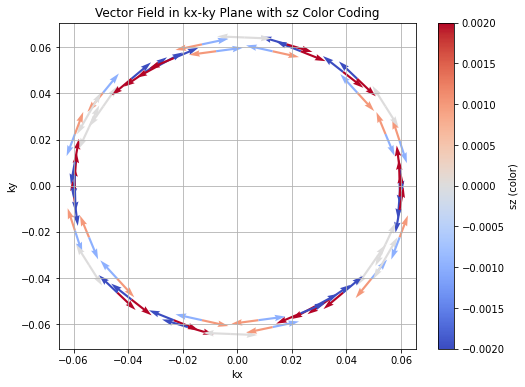

In [35]:
#To plot all the band 
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Load the CSV file (replace with your actual file path)
file_path = 'spin_expectations_at_iso-surface.csv'  # Update with your actual CSV file path
df = pd.read_csv(file_path)  # Use read_csv instead of read_excel for CSV files

# Inspect the column names to check if there are any issues
print("Column names in the CSV file:", df.columns)

# If needed, strip leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Extract the columns (ensure the correct column names are used here)
kx = df['kx']  # Replace 'kx' with the actual column name if different
ky = df['ky']  # Replace 'ky' with the actual column name if different
sx = df['sx']  # Replace 'sx' with the actual column name if different
sy = df['sy']  # Replace 'sy' with the actual column name if different
sz = df['sz']  # Replace 'sz' with the actual column name if different

# Create a quiver plot
plt.figure(figsize=(8, 6))

# Create a quiver plot with kx, ky as the origin, sx, sy as the vectors, and color by sz
quiver = plt.quiver(kx, ky, sx, sy, sz, scale=50, scale_units='xy', cmap='coolwarm')

# Add a color bar to show the color scale of sz
plt.colorbar(quiver, label='sz (color)')

# Label the axes
plt.xlabel('kx')
plt.ylabel('ky')

# Set the plot title
plt.title('Vector Field in kx-ky Plane with sz Color Coding')

# Show the plot
plt.grid(True)
plt.show()

Column names in the Excel file: Index(['kx', 'ky', 'band', 'sx', 'sy', 'sz'], dtype='object')


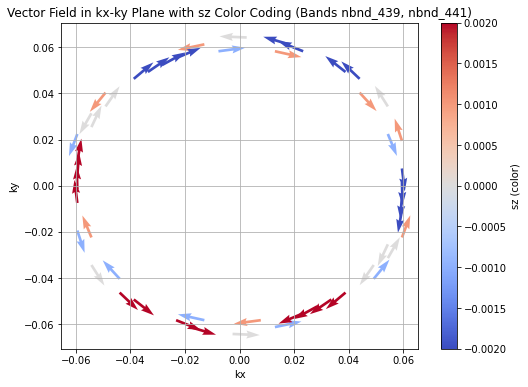

In [37]:
#To plot a list of  the band
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Load the Excel file (replace with your actual file path)
file_path = 'spin_expectations_at_iso-surface.csv'  # Update with your actual csv file path
df = pd.read_csv(file_path)  # Use read_excel instead of read_csv for Excel files

# Inspect the column names to check if there are any issues
print("Column names in the Excel file:", df.columns)

# If needed, strip leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Specify the bands to plot (replace 'band_column' with the actual column name for the band)
bands_to_plot = ['nbnd_439','nbnd_441']  # List of bands to plot, update with the actual band numbers
df_bands = df[df['band'].isin(bands_to_plot)]  # Replace 'band' with the correct column name if different

# Extract the columns (ensure the correct column names are used here)
kx = df_bands['kx']  # Replace 'kx' with the actual column name if different
ky = df_bands['ky']  # Replace 'ky' with the actual column name if different
sx = df_bands['sx']  # Replace 'sx' with the actual column name if different
sy = df_bands['sy']  # Replace 'sy' with the actual column name if different
sz = df_bands['sz']  # Replace 'sz' with the actual column name if different

# Create a quiver plot
plt.figure(figsize=(8, 6))

# Create a quiver plot with kx, ky as the origin, sx, sy as the vectors, and color by sz
quiver = plt.quiver(kx, ky, sx, sy, sz, scale=50, scale_units='xy', cmap='coolwarm')

# Add a color bar to show the color scale of sz
plt.colorbar(quiver, label='sz (color)')

# Label the axes
plt.xlabel('kx')
plt.ylabel('ky')

# Set the plot title, showing the bands being plotted
plt.title(f'Vector Field in kx-ky Plane with sz Color Coding (Bands {", ".join(map(str, bands_to_plot))})')

# Show the plot
plt.grid(True)
plt.show()


Fitted circle center: (4.956352788505163e-19, -3.097720492815727e-19), Radius: 0.05969202002285764


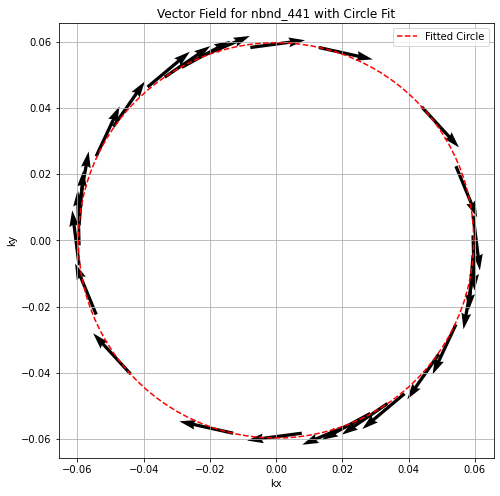

In [38]:
#To fit (kx,ky) in a circle of each band plot them.
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import leastsq

# Load the Excel file
file_path = 'spin_expectations_at_iso-surface.csv'  # Update with your actual csv file path
df = pd.read_csv(file_path)

# Specify the band to filter (e.g., 'nbnd_440')
band_col = 'nbnd_441'  # Change this to 'nbnd_441' or whichever band you want to work with

# Filter the dataframe to get data for this specific band
df_band = df[df['band'] == band_col]  # Ensure the band column matches the file's column

# Extract kx, ky, sx, sy, sz for this band
kx = df_band['kx']
ky = df_band['ky']
sx = df_band['sx']
sy = df_band['sy']
sz = df_band['sz']

# Define a function to fit a circle to kx, ky data points
def fit_circle(kx, ky):
    def calc_radius(params):
        xc, yc, r = params
        return np.sqrt((kx - xc) ** 2 + (ky - yc) ** 2) - r

    # Initial guess for circle center (xc, yc) and radius (r)
    x_m, y_m = np.mean(kx), np.mean(ky)
    r_initial = np.sqrt((kx - x_m) ** 2 + (ky - y_m) ** 2).mean()
    initial_guess = [x_m, y_m, r_initial]

    # Perform least-squares optimization to fit the circle
    circle_params, _ = leastsq(calc_radius, initial_guess)
    return circle_params

# Fit a circle to the kx, ky data points
xc, yc, radius = fit_circle(kx, ky)
print(f"Fitted circle center: ({xc}, {yc}), Radius: {radius}")

# Create a quiver plot
plt.figure(figsize=(8, 8))

# Plot the vectors (sx, sy) at points (kx, ky), colored by sz
quiver = plt.quiver(kx, ky, sx, sy, scale=30, scale_units='xy')

# Add a color bar to show the sz color scale
#plt.colorbar(quiver, label='sz (color)')

# Plot the fitted circle
theta = np.linspace(0, 2 * np.pi, 100)
x_circle = xc + radius * np.cos(theta)
y_circle = yc + radius * np.sin(theta)
plt.plot(x_circle, y_circle, 'r--', label='Fitted Circle')

# Label the axes
plt.xlabel('kx')
plt.ylabel('ky')

# Set the plot title
plt.title(f'Vector Field for {band_col} with Circle Fit')

# Set equal scaling for x and y axes
plt.gca().set_aspect('equal', adjustable='box')

# Show the plot
plt.legend()
plt.grid(True)
plt.show()


Fitted circle for nbnd_439: center = (-6.30808536718839e-19, -1.5770213417970974e-19), radius = 0.06332621660441864
Fitted circle for nbnd_441: center = (4.956352788505163e-19, -3.097720492815727e-19), radius = 0.05969202002285764


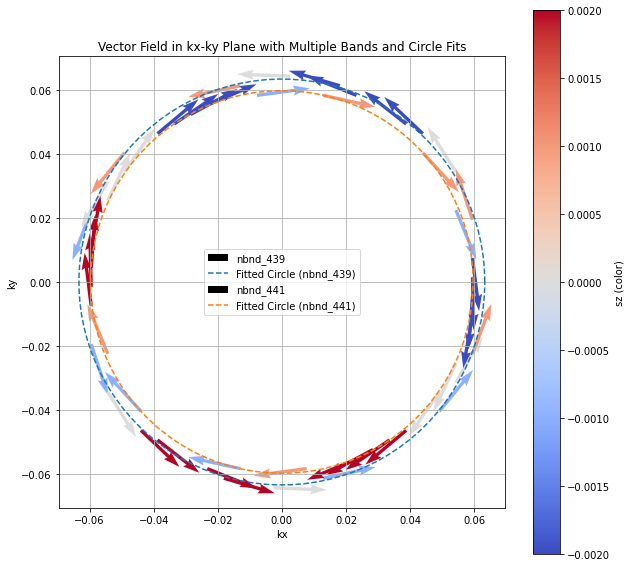

In [39]:
#To fit (kx,ky) in a circle of each band plot them(for a list of band)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import leastsq

# Load the Excel file
file_path = 'spin_expectations_at_iso-surface.csv'  # Update with your actual csv file path
df = pd.read_csv(file_path)

# List of bands you want to plot
bands_to_plot = ['nbnd_439','nbnd_441']  # Add as many bands as you want here

# Define a function to fit a circle to kx, ky data points
def fit_circle(kx, ky):
    def calc_radius(params):
        xc, yc, r = params
        return np.sqrt((kx - xc) ** 2 + (ky - yc) ** 2) - r

    # Initial guess for circle center (xc, yc) and radius (r)
    x_m, y_m = np.mean(kx), np.mean(ky)
    r_initial = np.sqrt((kx - x_m) ** 2 + (ky - y_m) ** 2).mean()
    initial_guess = [x_m, y_m, r_initial]

    # Perform least-squares optimization to fit the circle
    circle_params, _ = leastsq(calc_radius, initial_guess)
    return circle_params

# Create a quiver plot for multiple bands
plt.figure(figsize=(10, 10))

# Loop through each band and plot its data
for band_col in bands_to_plot:
    # Filter the dataframe to get data for this specific band
    df_band = df[df['band'] == band_col]  # Ensure the band column matches the file's column

    # Extract kx, ky, sx, sy, sz for this band
    kx = df_band['kx']
    ky = df_band['ky']
    sx = df_band['sx']
    sy = df_band['sy']
    sz = df_band['sz']

    # Fit a circle to the kx, ky data points
    xc, yc, radius = fit_circle(kx, ky)
    print(f"Fitted circle for {band_col}: center = ({xc}, {yc}), radius = {radius}")

    # Plot the vectors (sx, sy) at points (kx, ky), colored by sz
    quiver = plt.quiver(kx, ky, sx, sy, sz, scale=30, scale_units='xy', cmap='coolwarm', label=f'{band_col}')

    # Plot the fitted circle for each band
    theta = np.linspace(0, 2 * np.pi, 100)
    x_circle = xc + radius * np.cos(theta)
    y_circle = yc + radius * np.sin(theta)
    plt.plot(x_circle, y_circle, '--', label=f'Fitted Circle ({band_col})')

# Add a color bar to show the sz color scale (applies to the last band)
plt.colorbar(quiver, label='sz (color)')

# Label the axes
plt.xlabel('kx')
plt.ylabel('ky')

# Set the plot title
plt.title('Vector Field in kx-ky Plane with Multiple Bands and Circle Fits')

# Set equal scaling for x and y axes
plt.gca().set_aspect('equal', adjustable='box')

# Show the legend to differentiate between the bands
plt.legend()

# Show the grid
plt.grid(True)

# Save the figure as a PNG file
plt.savefig('spin_texture_plot_439_441.png', format='png')

# Show the plot
plt.show()